In [2]:
#scp -i "deepcoloring.pem" "images.zip" ubuntu@ec2-18-223-101-97.us-east-2.compute.amazonaws.com:~/interactive-deep-colorization
import numpy as np
import os
from skimage.measure import compare_ssim as ssim
from data import colorize_image as CI
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg
from PIL import Image

%matplotlib inline

# load images
imgs2read = open('imgs2read.txt', 'r')
allimgs2read = []
for line in imgs2read:
    line = line.strip()
    line = line.split()
    for img in line:
        if '-targets' in img:
            img = img.replace('-targets.png', '')
            allimgs2read.append(img)

# Choose gpu to run the model on
gpu_id = 0

# Initialize colorization class
colorModel = CI.ColorizeImageCaffe(Xd=256)

# Load the model
colorModel.prep_net(gpu_id,'./models/reference_model/deploy_nodist.prototxt','./models/reference_model/model.caffemodel')


ColorizeImageCaffe instantiated
gpu_id = 0, net_path = ./models/reference_model/deploy_nodist.prototxt, model_path = ./models/reference_model/model.caffemodel


In [3]:
import cv2

def ssim_fun(num_images):
    inputPath = "people_color_"+str(num_images) + "_test/images/"
    outputs = []
    targets = []
    ssim_arr = []

    # iterate through the names of contents of the folder
    for image_path in os.listdir(inputPath):
    #     # create the full input path and read the file
        img = cv2.imread(inputPath + image_path)
        if "outputs" in image_path:
            outputs.append(img)
        if "targets" in image_path:
            targets.append(img)
    for i in range(len(outputs)):
        ssim_arr.append(ssim(outputs[i], targets[i], multichannel=True))
    return ssim_arr, outputs, targets

def compute_ssim(images):
    outputs = []
    targets = []
    ssim_arr = []

    for img in images:
        img_url = './images/' + img
        output = cv2.imread(img_url + '-outputs.png')
        target = cv2.imread(img_url + '-targets.png')
        outputs.append(output)
        targets.append(target)
        
    for i in range(len(outputs)):
        ssim_arr.append(ssim(outputs[i], targets[i], multichannel=True))
    
    return outputs, targets, ssim_arr

def compute_ssimHINTS(images, numhints):
    outputs = []
    targets = []
    ssim_arr = []

    hint_num = '-' + str(numhints) + 'hints.png'
    for img in images:
        img_url = './images/' + img
        output = cv2.imread(img_url + hint_num)
        target = cv2.imread(img_url + '-targets.png')
        outputs.append(output)
        targets.append(target)
        
    for i in range(len(outputs)):
        ssim_arr.append(ssim(outputs[i], targets[i], multichannel=True))
    
    return outputs, targets, ssim_arr


In [4]:
import pandas as pd
df = pd.DataFrame()

outputs, targets, df["PIX2PIX"] = compute_ssim(allimgs2read)
outputs0HINTS, targets0HINTS, df["HINT(0)"] = compute_ssimHINTS(allimgs2read,0)
outputs1HINTS, targets1HINTS, df["HINT(1)"] = compute_ssimHINTS(allimgs2read,1)
outputs2HINTS, targets2HINTS, df["HINT(2)"] = compute_ssimHINTS(allimgs2read,2)
outputs3HINTS, targets3HINTS, df["HINT(3)"] = compute_ssimHINTS(allimgs2read,3)
outputs4HINTS, targets4HINTS, df["HINT(4)"] = compute_ssimHINTS(allimgs2read,4)
outputs5HINTS, targets5HINTS, df["HINT(5)"] = compute_ssimHINTS(allimgs2read,5)



('PIX2PIX', 0.9391723153779037)
('0 hints', 0.9484105341168653)
('1 hints', 0.9387217097736944)
('2 hints', 0.9355875320170987)
('3 hints', 0.9351035599769244)
('4 hints', 0.937070100437663)
('5 hints', 0.9372686421028393)


/home/ubuntu/anaconda3/envs/caffe_p27/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


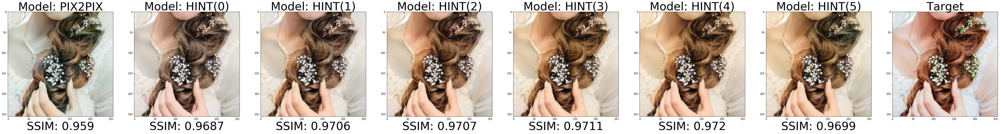

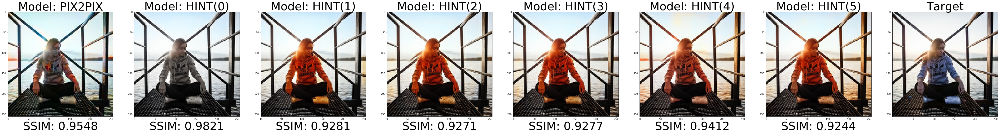

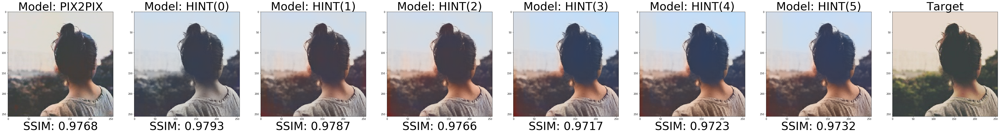

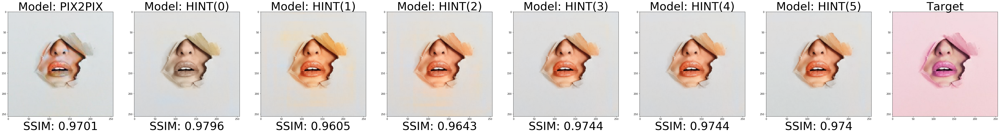

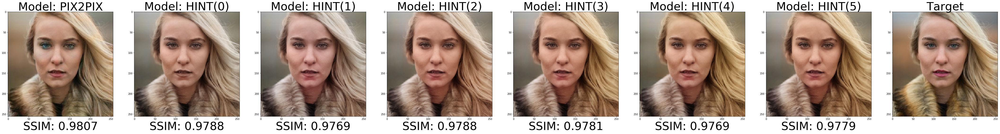

...

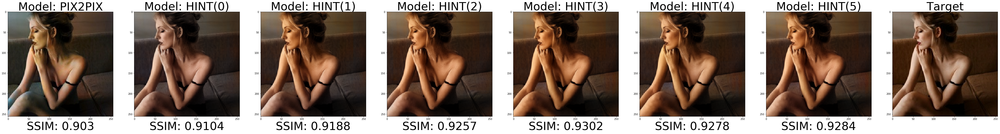

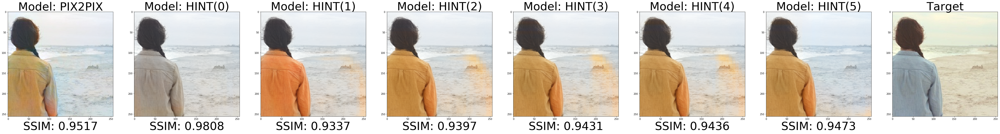

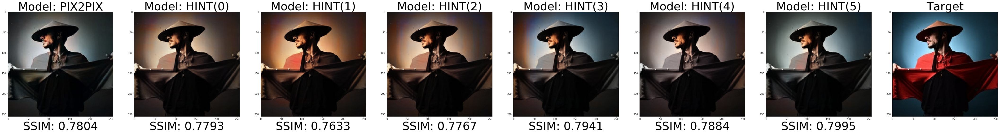

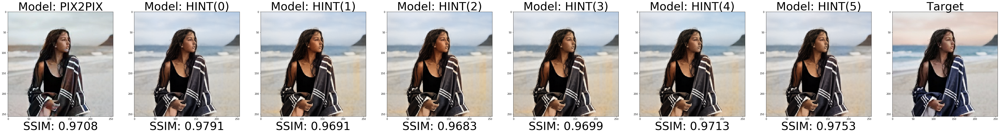

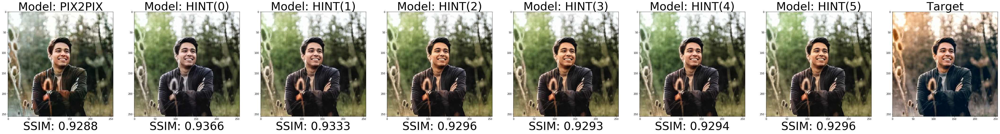

In [5]:

print("PIX2PIX", df["PIX2PIX"].mean())
print("0 hints", df["HINT(0)"].mean())
print("1 hints", df["HINT(1)"].mean())
print("2 hints", df["HINT(2)"].mean())
print("3 hints", df["HINT(3)"].mean())
print("4 hints", df["HINT(4)"].mean())
print("5 hints", df["HINT(5)"].mean())

count = 0

for img_num in range(len(allimgs2read)):
    
    if count == 30:
        break
#     img_num = 4
    fig, ax = plt.subplots(1,8)
    fig.set_figheight(75)
    fig.set_figwidth(75)

    im2 = targets[img_num].copy()
    im2[:, :, 0] = targets[img_num][:, :, 2]
    im2[:, :, 2] = targets[img_num][:, :, 0]
    ax[7].imshow(im2)
    ax[7].set_title(str("Target"), fontsize=48)

    epoch = ["PIX2PIX", "HINT(0)", "HINT(1)", "HINT(2)", "HINT(3)", "HINT(4)", "HINT(5)"]
    def display_image(image, i):
        im2 = image.copy()
        im2[:, :, 0] = image[:, :, 2]
        im2[:, :, 2] = image[:, :, 0]
        ax[i].imshow(im2)
        ax[i].set_xlabel(str("SSIM: "+ str(round(df[epoch[i]][img_num],4))), fontsize=48)
        ax[i].set_title(str("Model: "+ str(epoch[i])), fontsize=48)

    def display_images(img_num):
        display_image(outputs[img_num], 0)
        display_image(outputs0HINTS[img_num], 1)
        display_image(outputs1HINTS[img_num], 2)
        display_image(outputs2HINTS[img_num], 3)
        display_image(outputs3HINTS[img_num], 4)
        display_image(outputs4HINTS[img_num], 5)
        display_image(outputs5HINTS[img_num], 6)

    display_images(img_num)
    
    fig.savefig('./outputs/output' + '-' + allimgs2read[img_num]) 
    count+=1
    
plt.show()

In [ ]:
im2.show()

In [39]:
plt.savefig('outputs') 

In [33]:
plt.show()